<a href="https://colab.research.google.com/github/rafawaltrick/Pandas/blob/main/mapas1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.6/16.6 MB 57.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 86.9 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import datetime as dt
import geopandas as gpd
import folium
from shapely.geometry import Polygon, Point, LineString
%matplotlib inline
import matplotlib.pyplot as plt
plt.rc('figure', figsize = (15, 8))

In [ ]:
#dados_br = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/brasil/BR_Pais_2021.shp'
dados_amazonia_bioma = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/bioma amazonico/amazon_biome_border.shp'
dados_uc_am = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/bioma amazonico/conservation_units_amazon_biome.shp'
#dados_ti_am = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/bioma amazonico/indigenous_area_amazon_biome.shp'

In [ ]:
#focos20_shp = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/focos 2020/Focos_2020-01-01_2020-12-31.shp'
focosUC20_shp = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/focos 2020/focos_UC_20.shp'
#focosTI20_shp = '/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/focos 2020/focos_TI_20.shp'

In [ ]:
#dfg_focos20 =gpd.read_file(focos20_shp)
dfg_uc20 = gpd.read_file(focosUC20_shp)
#dfg_ti20 = gpd.read_file(focosTI20_shp)

In [ ]:
#dfg_br = gpd.read_file(dados_br)
dfg_uc_am = gpd.read_file(dados_uc_am)
#dgf_ti_am = gpd.read_file(dados_ti_am)
dfg_am_bioma = gpd.read_file(dados_amazonia_bioma)

In [ ]:
dfg_uc20

,datahora,satelite,pais,estado,municipio,bioma,diasemchuv,precipitac,riscofogo,latitude,longitude,frp,id,nome,categoria,grupo,esfera,ano_cria,geometry
0,2020/12/04 20:05:17,GOES-16,Brasil,AMAZONAS,PRESIDENTE FIGUEIREDO,Amazonia,2.0,0.0,-999.0,-1.77000,-59.92000,NaN,397,ÁREA DE PROTEÇÃO AMBIENTAL DE PRESIDENTE FIGUE...,Área de Proteção Ambiental,US,estadual,1990,MULTIPOINT (-59.92000 -1.77000)
1,2020/12/04 20:05:17,GOES-16,Brasil,AMAZONAS,PRESIDENTE FIGUEIREDO,Amazonia,2.0,0.0,0.1,-1.79000,-59.90000,NaN,397,ÁREA DE PROTEÇÃO AMBIENTAL DE PRESIDENTE FIGUE...,Área de Proteção Ambiental,US,estadual,1990,MULTIPOINT (-59.90000 -1.79000)
2,2020/12/05 16:48:00,NOAA-20,Brasil,PARA,ORIXIMINA,Amazonia,4.0,0.0,0.2,-1.13710,-57.09961,2.3,1081,FLORESTA ESTADUAL DE FARO,Floresta,US,estadual,2006,MULTIPOINT (-57.09961 -1.13710)
3,2020/12/04 18:00:00,NPP-375,Brasil,PARA,ORIXIMINA,Amazonia,2.0,0.0,0.2,-1.43676,-56.32730,5.5,1314,RESERVA BIOLÓGICA DO RIO TROMBETAS,Reserva Biológica,PI,federal,1979,MULTIPOINT (-56.32730 -1.43676)
4,2020/12/05 18:30:00,NOAA-20,Brasil,RONDONIA,GUAJARA-MIRIM,Amazonia,3.0,0.8,0.7,-10.72080,-64.93887,4.9,1344,RESERVA EXTRATIVISTA RIO OURO PRETO,Reserva Extrativista,US,federal,1990,MULTIPOINT (-64.93887 -10.72080)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
274203,2020/11/30 19:55:16,GOES-16,Brasil,MARANHAO,SERRANO DO MARANHAO,Amazonia,NaN,NaN,NaN,-1.90000,-45.04000,NaN,715,ÁREA DE PROTEçãO AMBIENTAL DAS REENTRâNCIAS MA...,Área de Proteção Ambiental,US,estadual,1991,MULTIPOINT (-45.04000 -1.90000)
274204,2020/11/30 19:45:14,GOES-16,Brasil,MARANHAO,SANTA HELENA,Amazonia,NaN,NaN,NaN,-2.23000,-45.14000,NaN,957,ÁREA DE PROTEçãO AMBIENTAL DA BAIXADA MARANHENSE,Área de Proteção Ambiental,US,estadual,1991,MULTIPOINT (-45.14000 -2.23000)
274205,2020/11/30 14:24:08,GOES-16,Brasil,RONDONIA,SAO FRANCISCO DO GUAPORE,Amazonia,NaN,NaN,NaN,-12.30000,-63.27000,NaN,511,RESERVA BIOLÓGICA DO GUAPORÉ,Reserva Biológica,PI,federal,1982,MULTIPOINT (-63.27000 -12.30000)
274206,2020/11/30 22:45:14,GOES-16,Brasil,MARANHAO,CENTRAL DO MARANHAO,Amazonia,NaN,NaN,NaN,-2.21000,-44.80000,NaN,715,ÁREA DE PROTEçãO AMBIENTAL DAS REENTRâNCIAS MA...,Área de Proteção Ambiental,US,estadual,1991,MULTIPOINT (-44.80000 -2.21000)


In [ ]:
# Para mostrar todos os dados do mapa e facilitar na visualização e renderização dos dados, vou utilizar um plugin do folium.
from folium.plugins import FastMarkerCluster

In [ ]:
# Primeiro trazemos a gdf(geodataframe) com os dados de fogo.
focos_uc_20 = dfg_uc20

#Retornar o zoom do mapa em relação a latitude e longitude dos focos.
media_lat = focos_uc_20['latitude'].mean()
media_lon = focos_uc_20['longitude'].mean()

#Trazemos o mapa com o parametro de localização das médias lat e lon.
mapa = folium.Map(location = [media_lat, media_lon], tiles = 'cartodbpositron')

#Adicionar as fronteiras do bioma. Trocar o estilo através do 'style_function'.
limites = folium.GeoJson(dfg_am_bioma,
                         style_function = lambda feture: {
                             'color': 'black',
                             #tamanho
                             'weight': 2,
                             #opacidade
                             'fillOpacity': 0.0
                         })

#Inserir os dados no mapa mas utilizando o plugin.
mc = FastMarkerCluster(dfg_uc20[['latitude', 'longitude']])

#Adicionar o 'limite' ao mapa.
mapa.add_child(limites)

#Adicionar os dados no mapa.
mapa.add_child(mc)

In [ ]:
#Salvar em html.
mapa.save('/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/focos 2020/mapa_uc_20.html')

In [ ]:
#Criando mapas de calor com o plugin HeatMap.
from folium.plugins import HeatMap

In [39]:
#Trazemos o mapa com o parametro de localização das médias lat e lon.
mapa = folium.Map(location = [media_lat, media_lon], tiles = 'cartodbpositron')

limites = folium.GeoJson(dfg_am_bioma,
                         style_function = lambda feture: {
                             'color': 'black',
                             #tamanho
                             'weight': 2,
                             #opacidade
                             'fillOpacity': 0.0
                         })

# Criar uma variável para montar o mapa de calor.
heat_map = HeatMap(dfg_uc20[['latitude','longitude']])

mapa.add_child(limites)

#Adicionar o heat_map ao 'mapa'.
mapa.add_child(heat_map)

mapa

In [ ]:
mapa.save('/content/drive/MyDrive/Colab Notebooks/dados prot_amazonas/dados/focos 2020/mapaDeCalor_uc_20.html')

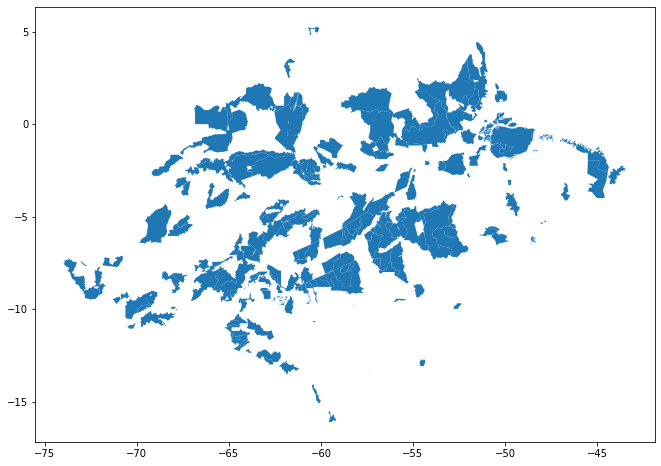

In [31]:
dfg_uc_am.plot()

In [40]:
dfg_uc_am.head()

,id,nome,categoria,grupo,esfera,ano_cria,geometry
0,51,RESERVA EXTRATIVISTA MARINHA CAETÉTAPERAÇU,Reserva Extrativista,US,federal,2005,"MULTIPOLYGON (((-46.62195 -0.94790, -46.62191 ..."
1,790,RESERVA EXTRATIVISTA DE CURURUPU,Reserva Extrativista,US,federal,2004,"MULTIPOLYGON (((-44.73181 -1.68514, -44.73103 ..."
2,76,RESERVA EXTRATIVISTA MARACANÃ,Reserva Extrativista,US,federal,2002,"MULTIPOLYGON (((-47.61416 -0.69361, -47.61334 ..."
3,243,RESERVA EXTRATIVISTA CHOCOARÉ-MATO GROSSO,Reserva Extrativista,US,federal,2002,"POLYGON ((-47.39115 -0.87928, -47.39110 -0.879..."
4,676,RESERVA EXTRATIVISTA SÃO JOÃO DA PONTA,Reserva Extrativista,US,federal,2002,"POLYGON ((-47.97406 -0.76569, -47.97400 -0.765..."


In [44]:
dfg_uc_am.geometry

0      MULTIPOLYGON (((-46.62195 -0.94790, -46.62191 ...
1      MULTIPOLYGON (((-44.73181 -1.68514, -44.73103 ...
2      MULTIPOLYGON (((-47.61416 -0.69361, -47.61334 ...
3      POLYGON ((-47.39115 -0.87928, -47.39110 -0.879...
4      POLYGON ((-47.97406 -0.76569, -47.97400 -0.765...
                             ...                        
299    POLYGON ((-62.47655 -9.30027, -62.47654 -9.303...
300    POLYGON ((-60.48916 -3.10041, -60.48916 -3.100...
301    MULTIPOLYGON (((-63.29869 -7.27243, -63.29954 ...
302    POLYGON ((-62.69123 -8.70499, -62.69142 -8.705...
303    POLYGON ((-59.42808 -15.82802, -59.42813 -15.8...
Name: geometry, Length: 304, dtype: geometry

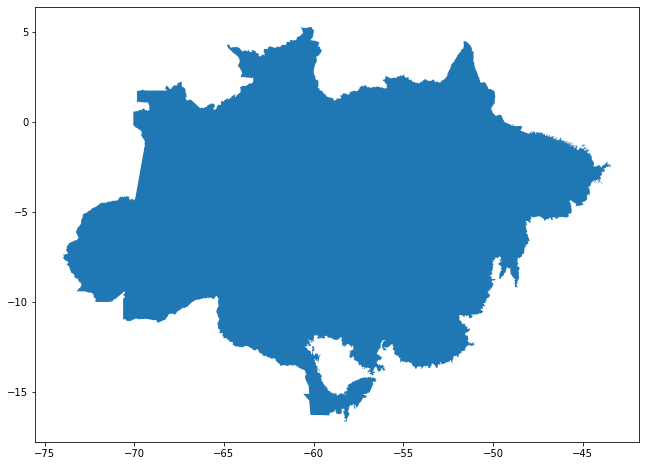

In [33]:
dfg_am_bioma.plot()

In [34]:
limites_uc_am = folium.GeoJson(dfg_uc_am,
                         style_function = lambda feture: {
                             'color': 'black',
                             #tamanho
                             'weight': 2,
                             #opacidade
                             'fillOpacity': 0.0
                         })

In [35]:
type(limites_uc_am)

folium.features.GeoJson